In [1]:
from otrpca import otrpca
from t_tools import *
import numpy as np
import matplotlib.pyplot as plt
from skimage.exposure import rescale_intensity

In [2]:
#to generate an example for the otrpca algorithm, we will use this function that  
#takes a tensor and stacks T copies of it along the 2nd (index 1) dimension
def stacker(L_0, T):
    
    L_0_expanded = np.expand_dims(L_0, 1)
    stacked_dims = np.array(L_0_expanded.shape)
    stacked_dims[1] = T
    L_0_stacked = np.empty(stacked_dims, dtype = complex)

    #slices from min to max for every dimension
    all_slice = [slice(0, stacked_dims[i]) for i in range(len(stacked_dims))]
    
    #for each i (ranging up to T) insert a copy
    for i in range(T):
        all_slice[1] = slice(i,i+1) 
        L_0_stacked[tuple(all_slice)] = L_0_expanded
        
    return(L_0_stacked)

In [3]:
#now we will generate a low rank tensor L_0
n = 20    #size of each dimension other than the 2nd dimension (indexed 1, 4 dimension tensor)
T = 40    #size of the 2nd dimensions (indexed 1)
rank = 5  #rank of the tensor

#generate problem: recover L_0 (and C_0) when given M_0
A = np.random.normal(0,1/n,(n,rank,n))
B = np.random.normal(0,1/n,(rank,n,n))
L_0 = stacker(t_prod(A, B), T)

In [4]:
#generate an example problem: recover L_0 (and C_0) when given M_0
rho = .1  #proportion of corrupted entries
var = 1 #variance of the normal distribution generating the noise
def add_noise(L_0, rho, var):
    S_0 = np.random.binomial(1,rho, L_0.shape)          #affected entries
    N   = np.random.normal(0, var, L_0.shape)           #noise into affected entries
    C_0 = S_0 * N

    return(C_0 + L_0, C_0)

M_0, C_0 = add_noise(L_0, rho, var)

In [7]:
#apply algorithm
L, C = otrpca(M_0)

copmuting SVD
finished svd
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b 

In [13]:
#test effectiveness
for i in range(T):
    print(np.linalg.norm(L[:,i,:,:] - L_0[:,i,:,:])/np.linalg.norm(L_0[:,i,:,:]))

0.5433437144989187
0.29773023096829465
0.23801761197782634
0.21692797394471744
0.20673158475531359
0.1981275857175637
0.18989045736519578
0.1873273515707801
0.186048736941653
0.1839067291555103
0.1824419692470636
0.18183352576843398
0.18172416984413958
0.17907720420596226
0.18064292766041606
0.1787574221101355
0.1804154847249933
0.178876711681579
0.17910419686976925
0.1781467002767796
0.17842805086946897
0.17794985988676942
0.17810161718291764
0.17700093039673748
0.1772447181895
0.17655509003869038
0.17641509950303597
0.17683251234042222
0.17634039606801238
0.17608642659374457
0.17621297260388652
0.17600755306472088
0.1755879887624735
0.17555674824221879
0.17558576019620079
0.17632815717465836
0.1768541311217957
0.17545064337314228
0.17569443850535515
0.17589079887242656


In [13]:
#lets try some real data
data = np.load('cloudy.npy')

In [14]:
#we will use this to make it easier to view the data
def plot(image, dpi_=150):
    img = np.real(image.copy())
    for b in range(image.shape[2]):
        tmp = image[:,:,b]
        pl, pu = np.percentile(tmp[np.isfinite(tmp)], (1, 99)) # 1-99% cut-off
        img[:,:,b] = rescale_intensity(image[:,:,b], in_range=(pl, pu), out_range=(0., 1.))

    plt.figure(dpi = dpi_)
    plt.imshow(img, interpolation='bilinear')
    plt.tick_params(axis='both', which='both', bottom= False, top=False, labelbottom=False, right=False, left=False, labelleft=False)
    plt.tight_layout()

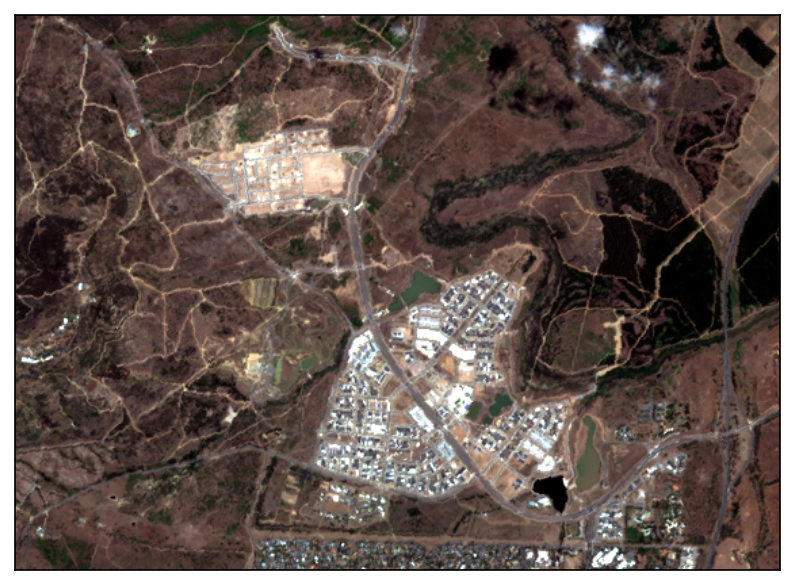

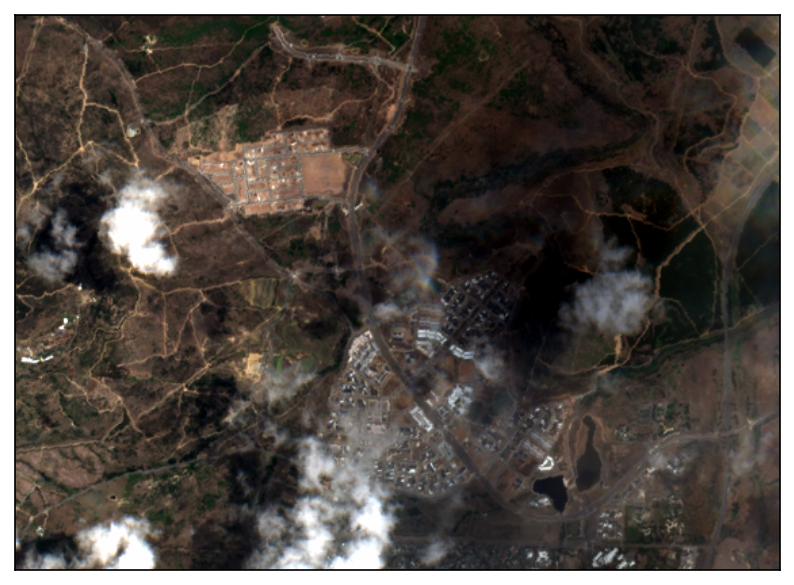

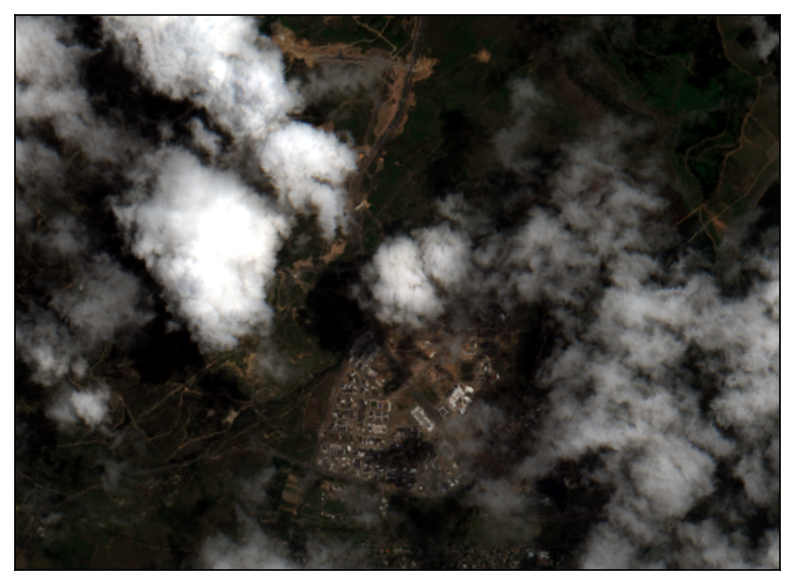

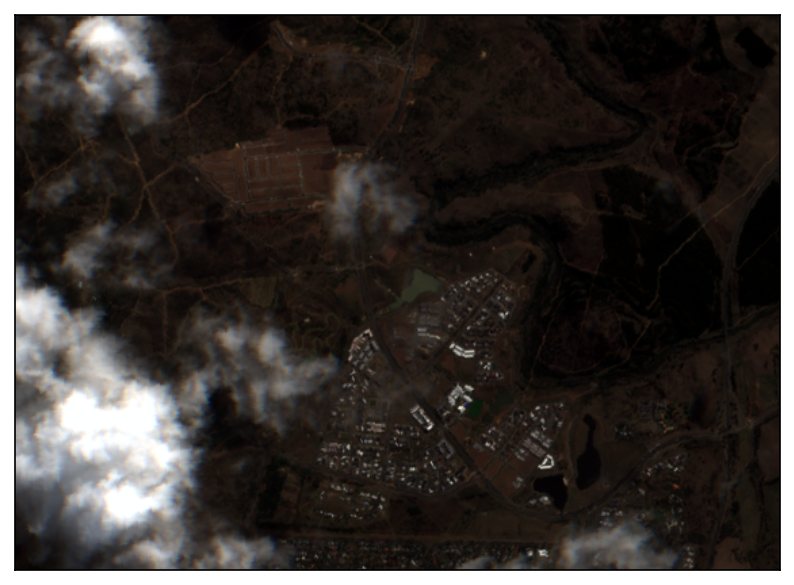

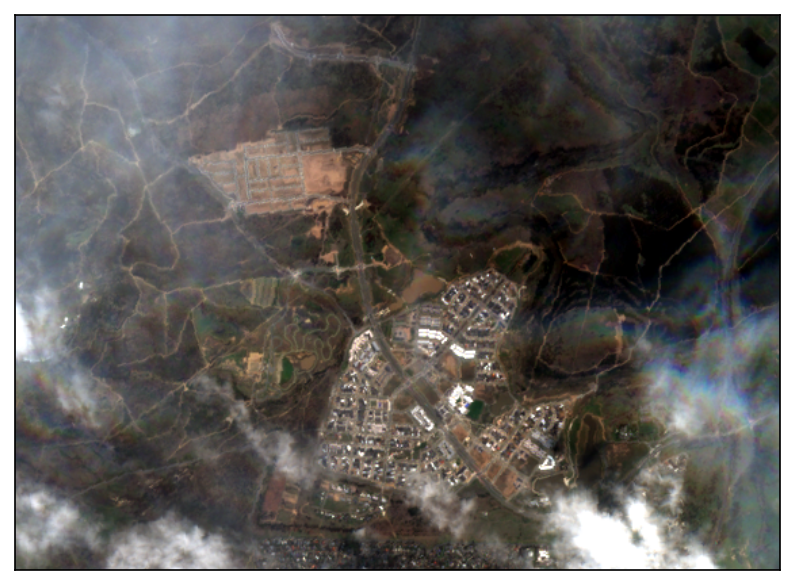

...

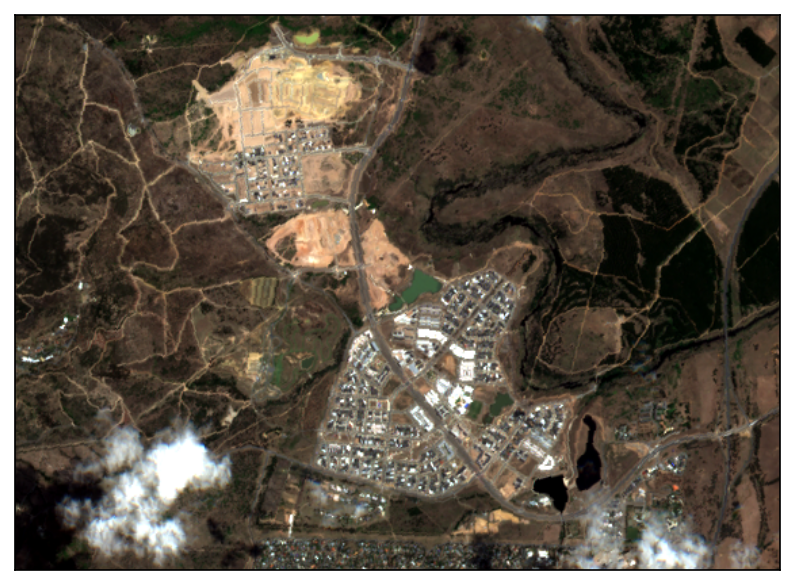

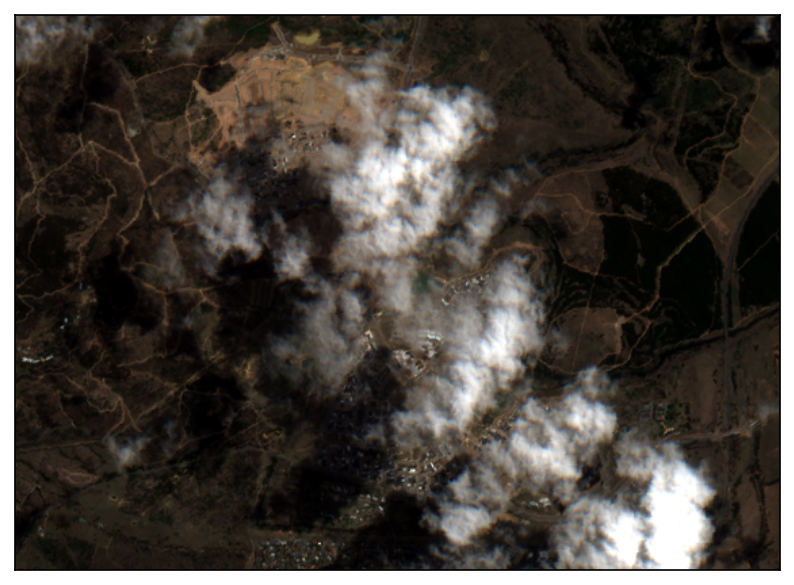

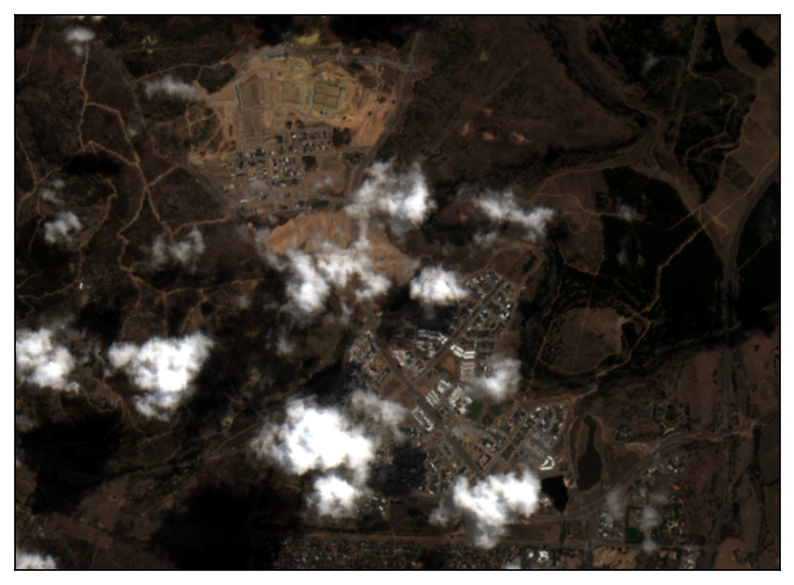

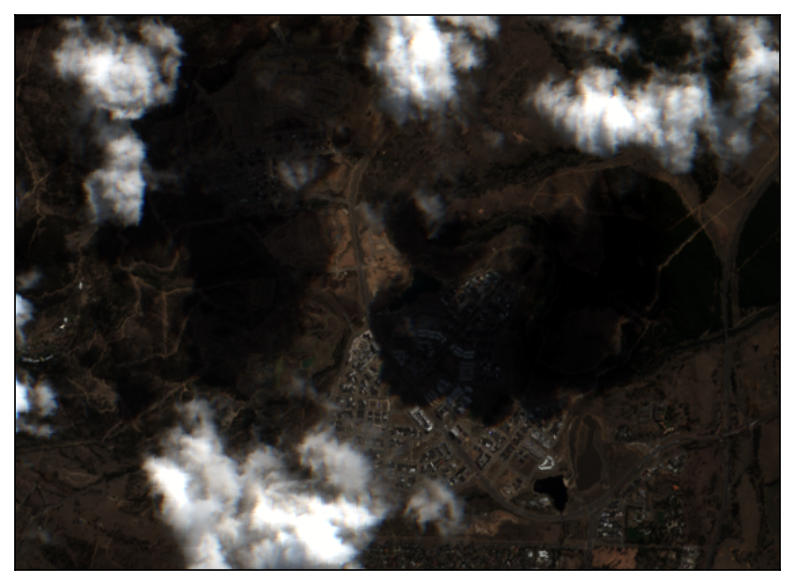

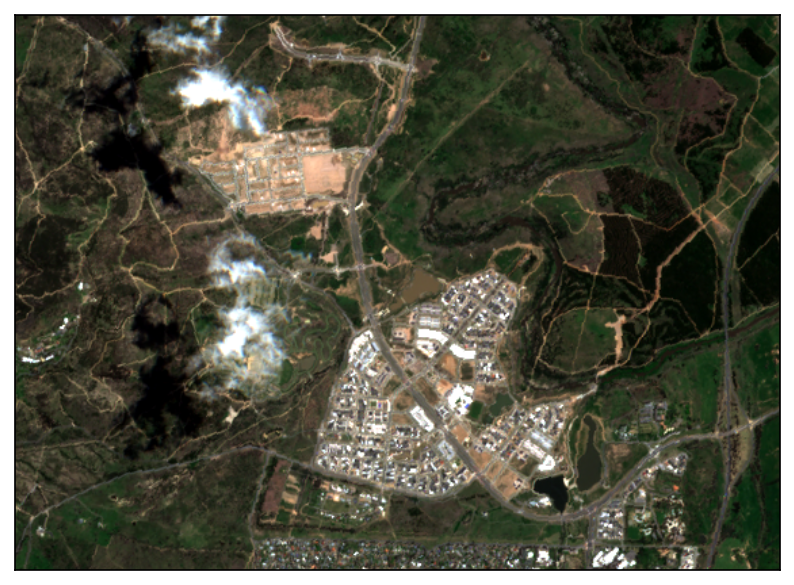

In [22]:
#dam clouds in the way (images are stacked along second (indexed 1) axis)
for i in range(len(cloud_index)):
    plot(cloudy[:,i,:,:])

In [13]:
#apply the algorithm
L, C = otrpca(cloudy, 3)

copmuting SVD
finished svd
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A
minimising b and c
minimising A


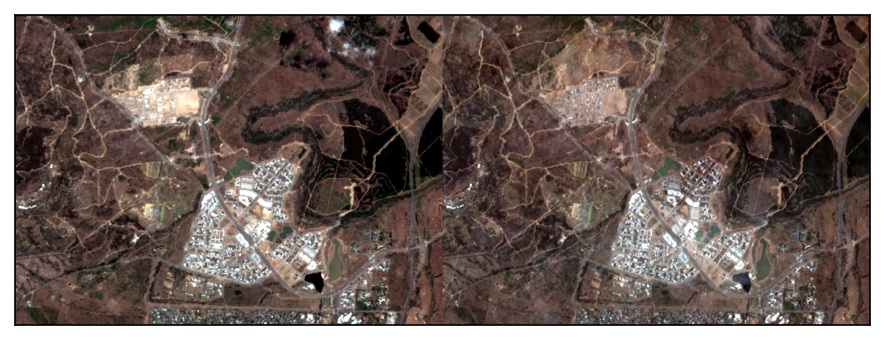

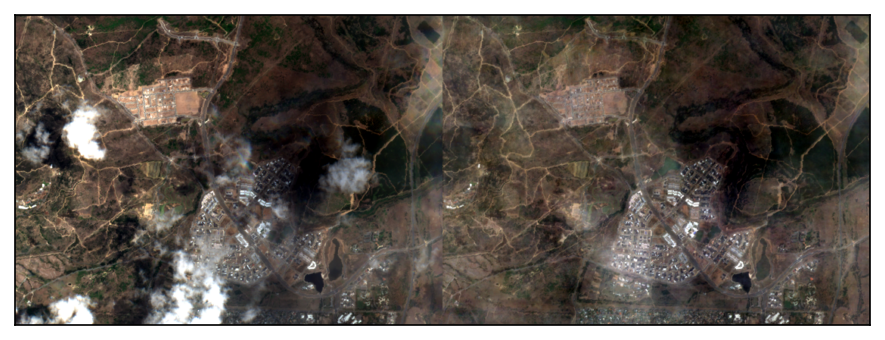

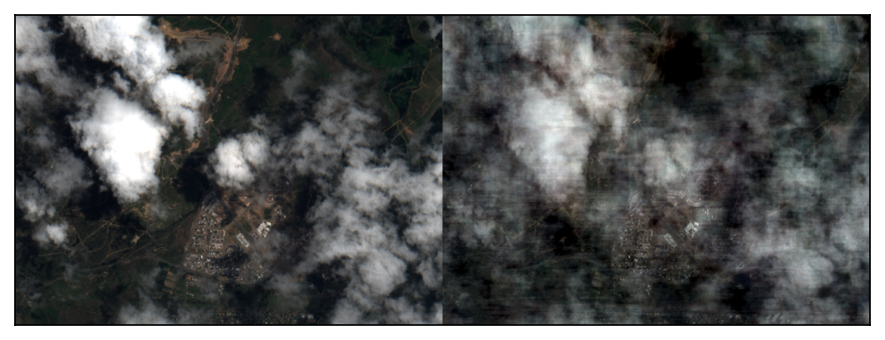

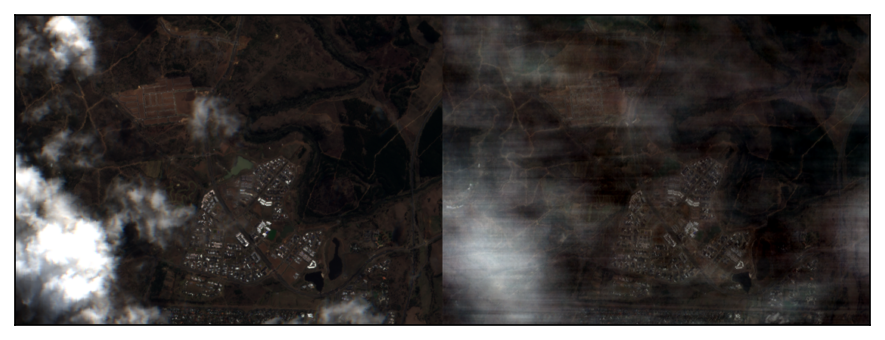

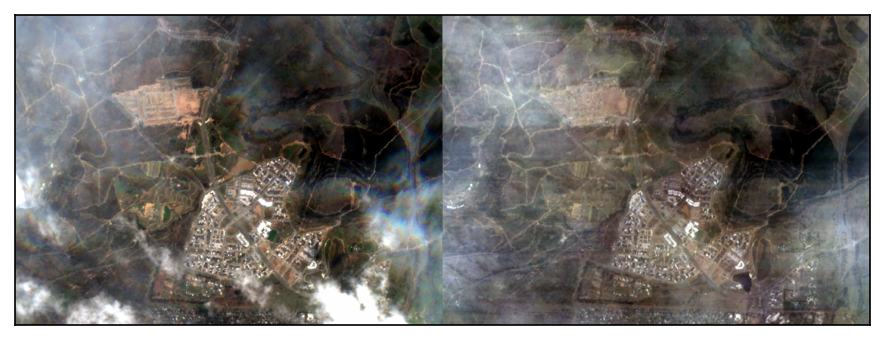

...

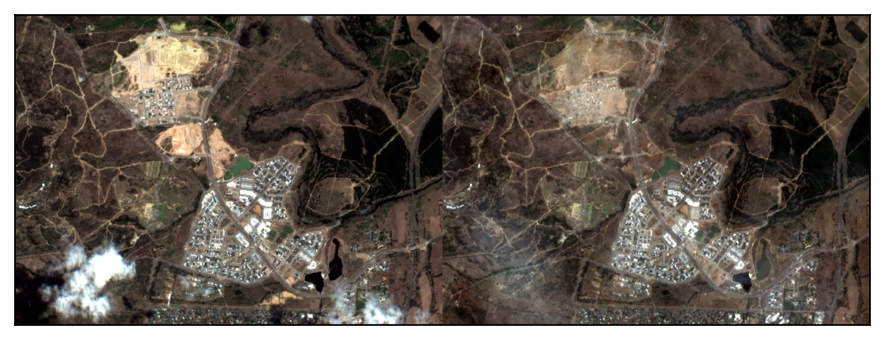

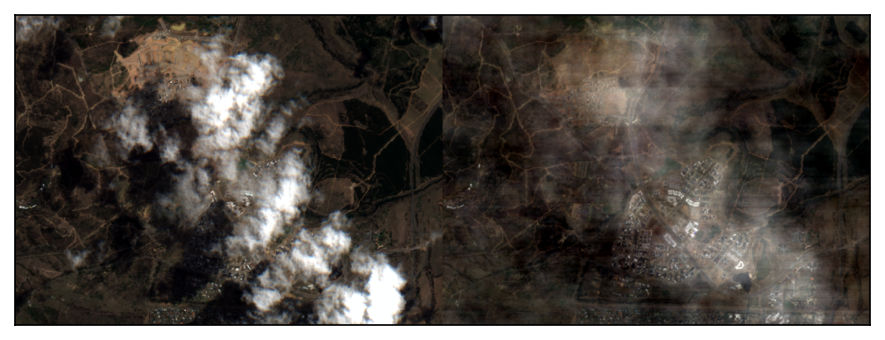

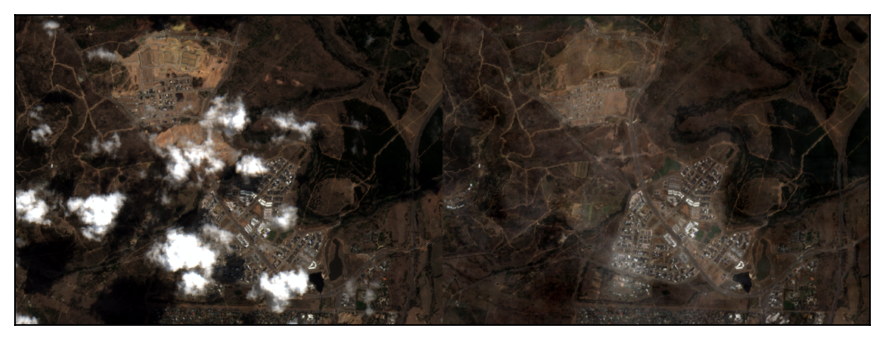

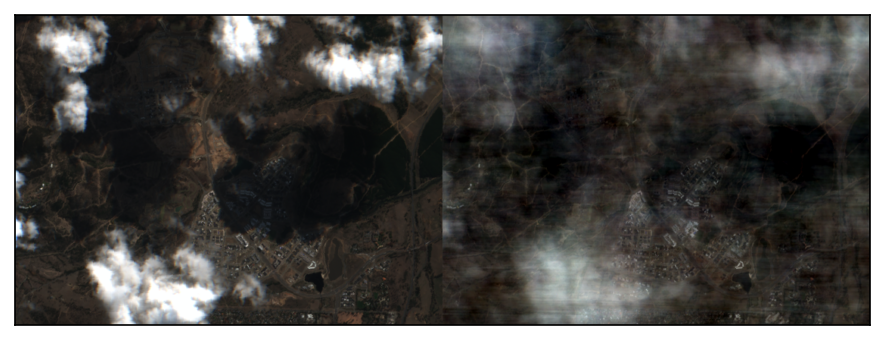

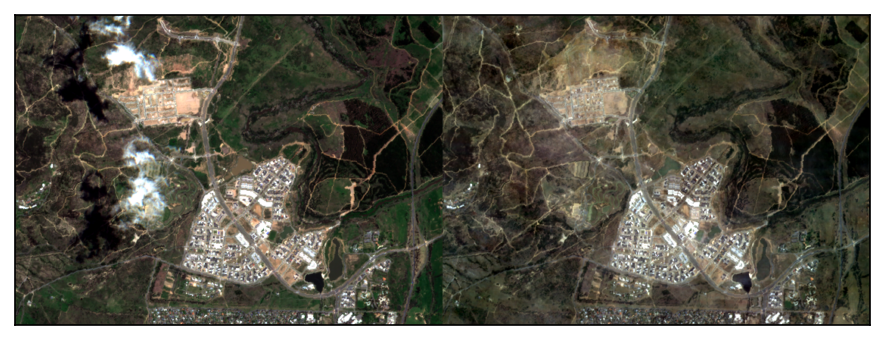

In [50]:
#see how it worked
for i in range(len(cloud_index)):
    plot(np.concatenate((cloudy[:,i,:,:], L[:,i,:,:]), axis = 1))


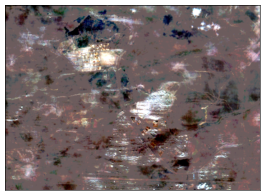

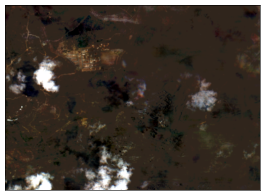

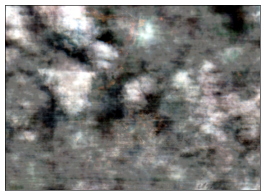

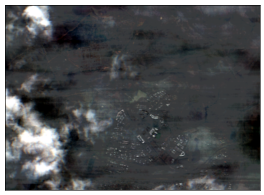

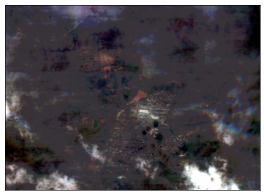

...

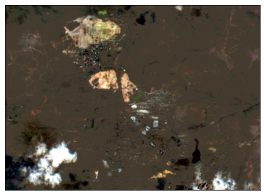

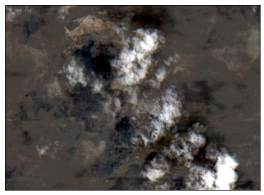

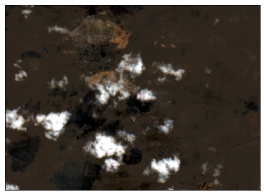

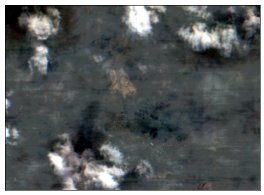

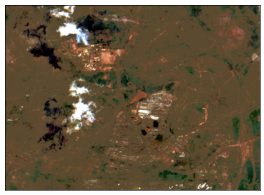

In [51]:
#here's what was removed
for i in range(len(cloud_index)):
    plot(C[:,i,:,:], 50)
